# Tanzania Water Wells
### Designing Classification Model

###### <font color='gray'>By: Jeonwook Kang, Adam Larsen, Roger Pineda</font>

# Overview
This project uses classificational modeling to accurately predict the current state of water wells that are spread throughout the African nation of Tanzania. The purpose for the prediction model is to aid The Tanzanian Water Project organization on finding water wells that are not functioning for them to go in and repair as wll as to give indicators on why the well is currently non-functional. We'll be focusing our efforts on a data set provided by the Tanzanian Ministry of Water. This data set, before cleaning, had roughly 60k data points as well as over 30 features for us to use in an effort to predict the status.
<br />
<br />

The steps we'll be taking so solve this problem will be::
- Fully grasping the problem at hand in Tanzania
- Explore and scrub our data
- Use various classification machine learning models
- Anaylyze results and hypertune our models for peak performance

# Business Understanding
Currently in Tanzania, there is a massive lack for almost half of their population with access to source of safe drinking water or improved sanitation areas. Already posing an incredibly tough challenege, various organizations across the world have spent hundreds of millions of dollars to try and help tackle this problem from the early 2000s when Tanzania came under incredibly large scrutiny to fix water crisis. Being an issue back then when 73% of locals didn't have any access to drinkable water, we can see we've made decent strides in trying to tackle this problem with the introduction of water wells across the various districts in Tanzania. Unfortunately, due to many different problems such as geographic location of the well, extraction techniques, installation techniques, and the group that manages the well, we're beginning to see that many of these wells require some tender love and care.

Our goal here is help the Tanzanian government, who is responsible for funding the majority of the wells across their country, to identify the statuses of failing wells in the most highly concentrated areas to ensure that the correct development teams can help get locals access to safe and drinkable water again.

----

# Data Preparation

In [1]:
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import seaborn as sns

import statsmodels.api as sm

from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.dummy import DummyClassifier

from sklearn.metrics import precision_score, recall_score, log_loss, plot_confusion_matrix,\
accuracy_score, f1_score, roc_auc_score, roc_curve, confusion_matrix

from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score, RandomizedSearchCV
from sklearn.preprocessing import OneHotEncoder, StandardScaler, label_binarize
from sklearn.impute import SimpleImputer
from sklearn.ensemble import RandomForestClassifier

import folium 
from folium.plugins import StripePattern
import geopandas as gpd
import warnings
warnings.filterwarnings("ignore")

In [2]:
X_df = pd.read_csv("data/Training_set_values.csv", index_col='id')
y_df = pd.read_csv("data/Training_set_labels.csv", index_col='id')

X_submit = pd.read_csv("data/Test_set_values.csv")

In [3]:
train_df = pd.merge(y_df, X_df, how='inner', on='id')

In [4]:
train_df['status'] = train_df.status_group.map({"non functional":0, "functional needs repair":1, "functional":2})

In [5]:
train_df

,status_group,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,...,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,status
id,,,,,,,,,,,,,,,,,,,,,
69572,functional,6000.0,2011-03-14,Roman,1390,Roman,34.938093,-9.856322,none,0,...,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe,2
8776,functional,0.0,2013-03-06,Grumeti,1399,GRUMETI,34.698766,-2.147466,Zahanati,0,...,soft,good,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,2
34310,functional,25.0,2013-02-25,Lottery Club,686,World vision,37.460664,-3.821329,Kwa Mahundi,0,...,soft,good,enough,enough,dam,dam,surface,communal standpipe multiple,communal standpipe,2
67743,non functional,0.0,2013-01-28,Unicef,263,UNICEF,38.486161,-11.155298,Zahanati Ya Nanyumbu,0,...,soft,good,dry,dry,machine dbh,borehole,groundwater,communal standpipe multiple,communal standpipe,0
19728,functional,0.0,2011-07-13,Action In A,0,Artisan,31.130847,-1.825359,Shuleni,0,...,soft,good,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60739,functional,10.0,2013-05-03,Germany Republi,1210,CES,37.169807,-3.253847,Area Three Namba 27,0,...,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe,2
27263,functional,4700.0,2011-05-07,Cefa-njombe,1212,Cefa,35.249991,-9.070629,Kwa Yahona Kuvala,0,...,soft,good,enough,enough,river,river/lake,surface,communal standpipe,communal standpipe,2
37057,functional,0.0,2011-04-11,NaN,0,NaN,34.017087,-8.750434,Mashine,0,...,fluoride,fluoride,enough,enough,machine dbh,borehole,groundwater,hand pump,hand pump,2


In [6]:
train_df.isna().sum()

status_group                 0
amount_tsh                   0
date_recorded                0
funder                    3635
gps_height                   0
installer                 3655
longitude                    0
latitude                     0
wpt_name                     0
num_private                  0
basin                        0
subvillage                 371
region                       0
region_code                  0
district_code                0
lga                          0
ward                         0
population                   0
public_meeting            3334
recorded_by                  0
scheme_management         3877
scheme_name              28166
permit                    3056
construction_year            0
extraction_type              0
extraction_type_group        0
extraction_type_class        0
management                   0
management_group             0
payment                      0
payment_type                 0
water_quality                0
quality_

In [7]:
num_dict = {}
dfp = train_df.copy().drop(['status_group', 'status'], axis =1)

for x in dfp.columns:
    if dfp[x].dtypes == 'object':
        num_dict[x] = len(dfp[x].value_counts())
num_dict

{'date_recorded': 356,
 'funder': 1897,
 'installer': 2145,
 'wpt_name': 37400,
 'basin': 9,
 'subvillage': 19287,
 'region': 21,
 'lga': 125,
 'ward': 2092,
 'public_meeting': 2,
 'recorded_by': 1,
 'scheme_management': 12,
 'scheme_name': 2696,
 'permit': 2,
 'extraction_type': 18,
 'extraction_type_group': 13,
 'extraction_type_class': 7,
 'management': 12,
 'management_group': 5,
 'payment': 7,
 'payment_type': 7,
 'water_quality': 8,
 'quality_group': 6,
 'quantity': 5,
 'quantity_group': 5,
 'source': 10,
 'source_type': 7,
 'source_class': 3,
 'waterpoint_type': 7,
 'waterpoint_type_group': 6}

In [8]:
train_df = train_df.drop(['scheme_name', 
                         'num_private', 
                         'lga', 
                         'ward', 
                         'recorded_by', 
                         'extraction_type',
                         'extraction_type_class',
                         'management_group',
                         'payment',
                         'water_quality',
                         'quantity',
                         'source',
                         'source_class',
                         'waterpoint_type',
                         'date_recorded',
                         'public_meeting',
                         'scheme_management',
                          'funder',
                          'installer',
                          'wpt_name',
                          'subvillage'], axis=1)
                        

In [9]:
train_df.isna().sum()

status_group                0
amount_tsh                  0
gps_height                  0
longitude                   0
latitude                    0
basin                       0
region                      0
region_code                 0
district_code               0
population                  0
permit                   3056
construction_year           0
extraction_type_group       0
management                  0
payment_type                0
quality_group               0
quantity_group              0
source_type                 0
waterpoint_type_group       0
status                      0
dtype: int64

In [10]:
train_df = train_df.dropna()

In [11]:
train_df.isna().sum()

status_group             0
amount_tsh               0
gps_height               0
longitude                0
latitude                 0
basin                    0
region                   0
region_code              0
district_code            0
population               0
permit                   0
construction_year        0
extraction_type_group    0
management               0
payment_type             0
quality_group            0
quantity_group           0
source_type              0
waterpoint_type_group    0
status                   0
dtype: int64

In [12]:
train_df['permit'] = train_df['permit'].astype(int)

In [13]:
X = train_df.drop(['status_group', 'status'], axis=1)
y = train_df['status']

In [14]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 56344 entries, 69572 to 26348
Data columns (total 18 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   amount_tsh             56344 non-null  float64
 1   gps_height             56344 non-null  int64  
 2   longitude              56344 non-null  float64
 3   latitude               56344 non-null  float64
 4   basin                  56344 non-null  object 
 5   region                 56344 non-null  object 
 6   region_code            56344 non-null  int64  
 7   district_code          56344 non-null  int64  
 8   population             56344 non-null  int64  
 9   permit                 56344 non-null  int64  
 10  construction_year      56344 non-null  int64  
 11  extraction_type_group  56344 non-null  object 
 12  management             56344 non-null  object 
 13  payment_type           56344 non-null  object 
 14  quality_group          56344 non-null  object 
 15

In [15]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=16)

In [ ]:
ohe = OneHotEncoder(categories='auto', sparse=False, drop='first')
ss = StandardScaler()

In [63]:
X_train_ohe = X_train.select_dtypes('object')
X_train_ohe = pd.concat([X_train_ohe, X_train[['region_code', 'district_code']]], axis=1)
ohe.fit(X_train_ohe)
X_train_ohe_trans = ohe.transform(X_train_ohe)
train_temp_df = pd.DataFrame(X_train_ohe_trans, columns=ohe.get_feature_names(), index=X_train.index)

X_train_ss = X_train.select_dtypes(exclude='object').drop(['permit','region_code','district_code'], axis=1)
ss.fit(X_train_ss)
X_train_scaled = ss.transform(X_train_ss)
train_temp_df1 = pd.DataFrame(X_train_scaled, index=X_train.index, columns=X_train_ss.columns)

train_temp_df2 = X_train[['permit']]


X_train_clean = pd.concat([train_temp_df1, train_temp_df2, train_temp_df], axis=1)

In [64]:
X_test_ohe = X_test.select_dtypes('object')
X_test_ohe = pd.concat([X_test_ohe, X_test[['region_code', 'district_code']]], axis=1)
X_test_ohe_trans = ohe.transform(X_test_ohe)
test_temp_df = pd.DataFrame(X_test_ohe_trans, columns=ohe.get_feature_names(), index=X_test.index)

X_test_ss = X_test.select_dtypes(exclude='object').drop(['permit','region_code','district_code'], axis=1)
X_test_scaled = ss.transform(X_test_ss)
test_temp_df1 = pd.DataFrame(X_test_scaled, index=X_test.index, columns=X_test_ss.columns)

test_temp_df2 = X_test[['permit']]


X_test_clean = pd.concat([test_temp_df1, test_temp_df2, test_temp_df], axis=1)

In [65]:
X_train_clean.head()

,amount_tsh,gps_height,longitude,latitude,population,construction_year,permit,x0_Lake Nyasa,x0_Lake Rukwa,x0_Lake Tanganyika,...,x10_23,x10_30,x10_33,x10_43,x10_53,x10_60,x10_62,x10_63,x10_67,x10_80
id,,,,,,,,,,,,,,,,,,,,,
39029,-0.098932,-0.983487,0.846746,-0.766445,-0.300034,-1.366640,0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
5015,-0.116706,1.361636,-0.638361,0.360566,0.045715,0.744371,1,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
63663,-0.116706,-0.950192,-0.339696,1.089090,-0.386471,-1.366640,1,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
49199,-0.116706,-0.950192,0.278312,-0.312155,-0.386471,-1.366640,1,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
47678,-0.116706,1.532454,0.389907,0.815197,0.045715,0.734914,1,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [66]:
X_test_clean.head()

,amount_tsh,gps_height,longitude,latitude,population,construction_year,permit,x0_Lake Nyasa,x0_Lake Rukwa,x0_Lake Tanganyika,...,x10_23,x10_30,x10_33,x10_43,x10_53,x10_60,x10_62,x10_63,x10_67,x10_80
id,,,,,,,,,,,,,,,,,,,,,
39883,-0.116706,-0.950192,-0.359450,1.275847,-0.386471,-1.366640,1,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
59889,0.238777,-0.950192,0.488632,-0.266911,1.134824,0.744371,1,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
12400,-0.116706,-0.950192,-5.057856,1.928976,-0.386471,-1.366640,1,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
65058,0.238777,1.539692,0.199115,-0.786859,1.018134,0.744371,1,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1395,-0.106041,-0.893736,0.689792,-0.023396,8.257252,0.741219,0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


# Classification Model Results

In [19]:
def model_score(model, X, y_predict, y_true):
    acc = accuracy_score(y_predict, y_true)
    rec = recall_score(y_predict, y_true, average='weighted')
    f1 = f1_score(y_predict, y_true, average='weighted')
    prec = precision_score(y_predict, y_true, average='weighted')
    cross = cross_val_score(estimator=model, X=X, y=y_true, cv=10).mean()
    
    print(f' The accuracy score is: {round(acc, 4)}')
    print(f' The cross validation score of accuracy is: {round(cross, 4)}')
    print(f' The recall score is: {round(rec, 4)}')
    print(f' The F1 score is: {round(f1, 4)}')
    print(f' The precision score is: {round(prec, 4)}')
    
    return plot_confusion_matrix(model, X, y_true);

0.444405004880646


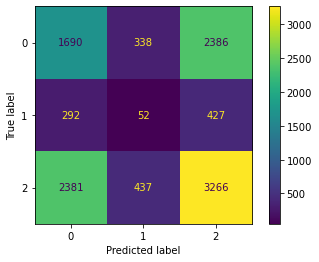

In [20]:
dummy = DummyClassifier(random_state=16)
dummy.fit(X_train_clean, y_train)
print(dummy.score(X_test_clean, y_test))

plot_confusion_matrix(dummy, X_test_clean, y_test);

Training data model score:
 The accuracy score is: 0.7391
 The cross validation score of accuracy is: 0.7375
 The recall score is: 0.7391
 The F1 score is: 0.7661
 The precision score is: 0.8122


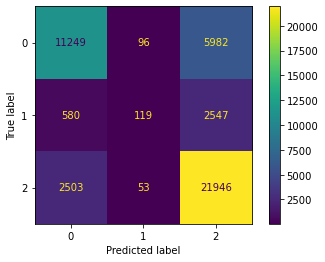

In [21]:
log_model = LogisticRegression(multi_class = "multinomial")
log_model.fit(X_train_clean, y_train)
log_y_pred_train = log_model.predict(X_train_clean)

print("Training data model score:")
log_train_score = model_score(log_model, X_train_clean, log_y_pred_train, y_train)

In [22]:
log_reg = sm.GLM(y_train, X_train_clean).fit()
log_reg.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                 status   No. Observations:                45075
Model:                            GLM   Df Residuals:                    44961
Model Family:                Gaussian   Df Model:                          113
Link Function:               identity   Scale:                         0.58909
Method:                          IRLS   Log-Likelihood:                -51960.
Date:                Fri, 10 Dec 2021   Deviance:                       26469.
Time:                        10:27:44   Pearson chi2:                 2.65e+04
No. Iterations:                     3                                         
Covariance Type:            nonrobust                                         
==============================================================================================
                                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------
amount_tsh                     0.0123      0.004      3.287      0.001       0.005       0.020
gps_height                     0.0238      0.011      2.222      0.026       0.003       0.045
longitude                     -0.0141      0.008     -1.853      0.064      -0.029       0.001
latitude                      -0.0068      0.030     -0.226      0.821      -0.066       0.052
population                     0.0251      0.004      6.345      0.000       0.017       0.033
construction_year             -0.0051      0.012     -0.420      0.675      -0.029       0.019
permit                         0.1366      0.010     13.253      0.000       0.116       0.157
x0_Lake Nyasa                  0.3858      0.042      9.279      0.000       0.304       0.467
x0_Lake Rukwa                 -0.0966      0.038     -2.572      0.010      -0.170      -0.023
x0_Lake Tanganyika             0.0137      0.026      0.521      0.602      -0.038       0.065
x0_Lake Victoria               0.0335      0.027      1.236      0.216      -0.020       0.087
x0_Pangani                    -0.1383      0.029     -4.753      0.000      -0.195      -0.081
x0_Rufiji                      0.1199      0.035      3.472      0.001       0.052       0.188
x0_Ruvuma / Southern Coast     0.2602      0.051      5.099      0.000       0.160       0.360
x0_Wami / Ruvu                 0.0154      0.031      0.494      0.621      -0.046       0.076
x1_Dar es Salaam            -1.58e+10   3.72e+10     -0.425      0.671   -8.87e+10    5.71e+10
x1_Dodoma                     -0.4818      0.214     -2.249      0.024      -0.902      -0.062
x1_Iringa                  -5.879e+09   1.38e+10     -0.425      0.671    -3.3e+10    2.12e+10
x1_Kagera                   3.053e+10   7.18e+10      0.425      0.671    -1.1e+11    1.71e+11
x1_Kigoma                  -4.174e+10   9.82e+10     -0.425      0.671   -2.34e+11    1.51e+11
x1_Kilimanjaro               -6.9e+10   1.62e+11     -0.425      0.671   -3.87e+11    2.49e+11
x1_Lindi                    3.053e+10   7.18e+10      0.425      0.671    -1.1e+11    1.71e+11
x1_Manyara                 -3.446e+10   8.11e+10     -0.425      0.671   -1.93e+11    1.24e+11
x1_Mara                    -2.977e+10      7e+10     -0.425      0.671   -1.67e+11    1.08e+11
x1_Mbeya                   -5.033e+10   1.18e+11     -0.425      0.671   -2.82e+11    1.82e+11
x1_Morogoro                 3.068e+09   7.22e+09      0.425      0.671   -1.11e+10    1.72e+10
x1_Mtwara                    7.46e+09   1.76e+10      0.425      0.671   -2.69e+10    4.19e+10
x1_Mwanza                  -5.879e+09   1.38e+10     -0.425      0.671    -3.3e+10    2.12e+10
x1_Pwani                    3.374e+10   7.94e+10      0.425      0.671   -1.22e+11    1.89e+11
x1_Rukwa                   -5.927e+10   1.3

In [23]:
knn = KNeighborsClassifier()
grid = {
    'n_neighbors' : [5, 11, 21, 31, 41]
}
# knn_grid_search = GridSearchCV(knn, grid, cv=3)
# knn_grid_search.fit(X_train_clean, y_train)

# knn_grid_search.best_params_

In [24]:
knn = KNeighborsClassifier()
grid = {
    'n_neighbors' : [1, 3, 5, 7, 9]
}
# knn_grid_search = GridSearchCV(knn, grid, cv=3)
# knn_grid_search.fit(X_train_clean, y_train)

# knn_grid_search.best_params_

Training data model score:
 The accuracy score is: 0.8159
 The cross validation score of accuracy is: 0.7636
 The recall score is: 0.8159
 The F1 score is: 0.8209
 The precision score is: 0.8297


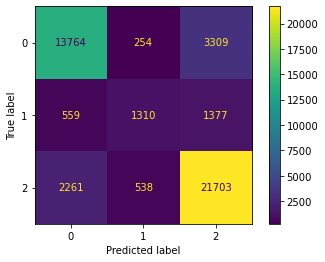

In [25]:
knn_model = KNeighborsClassifier(n_neighbors=7)
knn_model.fit(X_train_clean, y_train)
knn_model_pred = knn_model.predict(X_train_clean)

print("Training data model score:")
knn_model_score = model_score(knn_model, X_train_clean, knn_model_pred, y_train)

In [26]:
dt = DecisionTreeClassifier(criterion='gini', max_depth=30, min_impurity_split=0.3, min_samples_split=2)
dt_grid = {
    'criterion' : ['entropy', 'gini'],
    'max_depth': [10,20,30,40,50,60, None],
    'min_samples_split' : [1, 2, 5, 10, 20, 30],
    'min_impurity_decrease' : [0.0, 0.1, 0.2, 0.3,0.4, 0.5],
    'min_impurity_split' : [None, 0.1, 0.2, 0.3, 0.4, 0.5],
}

# gs_dt = GridSearchCV(estimator=dt , param_grid=dt_grid, cv=5)
# gs_dt.fit(X_train_clean, y_train)

# print(f'Best parameters are {gs_dt.best_params_}')
# print(f'Best score {gs_dt.best_score_}')
# print(f'Best estimator score {gs_dt.best_estimator_.score(X_test_clean, y_test)}')

Training data model score:
 The accuracy score is: 0.8856
 The cross validation score of accuracy is: 0.7701
 The recall score is: 0.8856
 The F1 score is: 0.8884
 The precision score is: 0.8965


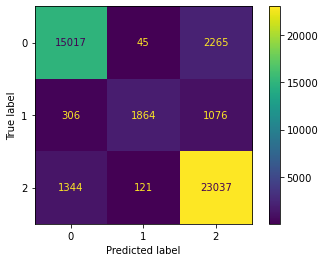

In [27]:
dt_model = DecisionTreeClassifier(criterion='gini', max_depth=30, min_impurity_split=0.3, min_samples_split=2)
dt_model.fit(X_train_clean, y_train)
dt_model_pred = dt_model.predict(X_train_clean)

print("Training data model score:")
dt_model_score = model_score(dt_model, X_train_clean, dt_model_pred, y_train)

In [28]:
rf_model = RandomForestClassifier(bootstrap=True, criterion='gini', max_depth=20)
rf_model.fit(X_train_clean, y_train)

#scores on folds
scores = cross_val_score(estimator=rf_model, X=X_train_clean, y=y_train, cv=5)
print(np.mean(scores))

#scores on on test
score = rf_model.score(X_test_clean, y_test)
print(score)

# grid search on random forest
# grid = {
#     'criterion' : ['entropy', 'gini'],
#     'max_depth': [5,10,15,20, None],
#     'min_impurity_decrease' : [0.0, 0.1, 0.2, 0.3,0.4, 0.5], #values selected based on gini   
#     'min_impurity_split' : [None, 0.1, 0.2, 0.3, 0.4, 0.5], #values selected based on gini
#     'bootstrap' : [False, True] 
# }
# gs = GridSearchCV(estimator=random_forest , param_grid=grid, cv=5)
# gs.fit(X_train_clean, y_train)

# print(f'Best parameters are {gs.best_params_}')
# print(f'Best score {gs.best_score_}')
# print(f'Best estimator score {gs.best_estimator_.score(X_test_clean, y_test)}')

0.7988907376594565
0.8055728103647174


In [29]:
rf_model_pred = rf_model.predict(X_train_clean)

Training data model score:
 The accuracy score is: 0.9216
 The cross validation score of accuracy is: 0.8024
 The recall score is: 0.9216
 The F1 score is: 0.9248
 The precision score is: 0.9359


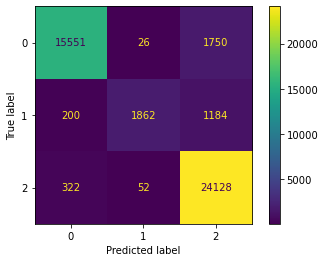

In [30]:
print("Training data model score:")
rf_model_score = model_score(rf_model, X_train_clean, rf_model_pred, y_train)

In [31]:
cm = np.array([[17590, 2983],
       [386, 24116]])

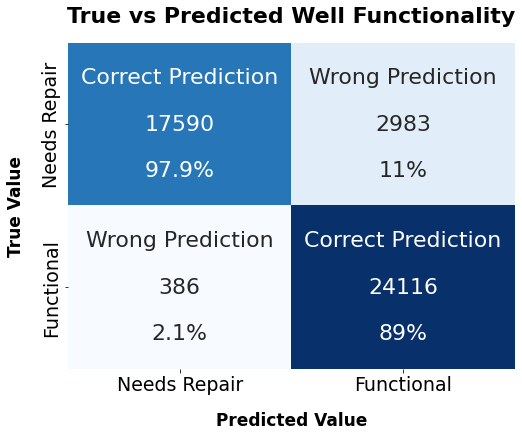

In [32]:
group_names = ["Correct Prediction","Wrong Prediction","Wrong Prediction","Correct Prediction"]
group_counts = ["{0:0.0f}".format(value) for value in
                cm.flatten()]
group_percentages = ["97.9%", "11%", "2.1%", "89%"]
labels = [f"{v1}\n\n{v2}\n\n{v3}" for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)


fig, ax = plt.subplots(figsize=(8,6))
ax = sns.heatmap(cm, annot=labels, fmt='', annot_kws={"size":22}, cmap="Blues", cbar=False)
ax.set_title("True vs Predicted Well Functionality", fontweight='bold', fontsize=22, pad=20)
ax.set_xlabel("Predicted Value", fontweight='bold', fontsize=17, labelpad=17)
ax.set_ylabel("True Value", fontweight='bold', fontsize=17, labelpad=17)
ax.xaxis.set_ticklabels(['Needs Repair', 'Functional'], fontsize=19)
ax.yaxis.set_ticklabels(['Needs Repair', 'Functional'], fontsize=19, va="center");

In [33]:
baseline = dummy.score(X_test_clean, y_test)
logistic = log_model.score(X_test_clean, y_test)
knneighbors = knn_model.score(X_test_clean, y_test)
decision_tree = dt_model.score(X_test_clean, y_test)
random_forest = rf_model.score(X_test_clean, y_test)

acc_dict = {"accuracy":{"baseline":baseline, 
            "logistic":logistic, 
            "knneighbors":knneighbors, 
            "decision tree":decision_tree, 
            "random forest":random_forest}}

accuracy_df = pd.DataFrame.from_dict(acc_dict)

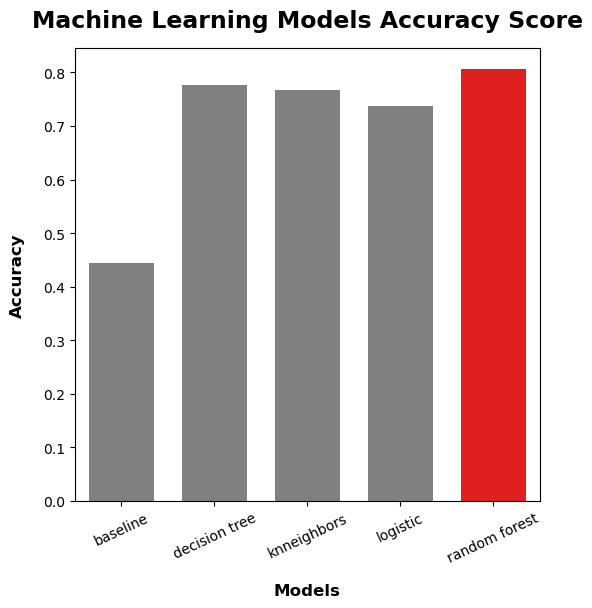

In [34]:
def change_width(ax, new_value) :
    for patch in ax.patches :
        current_width = patch.get_width()
        diff = current_width - new_value
        patch.set_width(new_value)
        patch.set_x(patch.get_x() + diff * .5)
        
fig, ax = plt.subplots(figsize=(6,6), dpi=100)

x = accuracy_df.index
y = accuracy_df['accuracy']
clrs=['red' if x == 'random forest' else 'grey' for x in x]

ax = sns.barplot(x=x, y=y, palette=clrs)
ax.set_xticklabels(x, rotation=25)
ax.set_title("Machine Learning Models Accuracy Score", fontweight='bold', fontsize=17, pad=15)
ax.set_ylabel("Accuracy", fontweight='bold', fontsize=12, labelpad=13)
ax.set_xlabel("Models", fontweight='bold', fontsize=12, labelpad=13)
change_width(ax, 0.7);

In [35]:
y_binary_test = label_binarize(y_test, classes=[0, 1, 2])

dt_model_pred_proba = dt_model.predict_proba(X_test_clean)
rf_model_pred_proba = rf_model.predict_proba(X_test_clean)
knn_model_pred_proba = knn_model.predict_proba(X_test_clean)
log_model_pred_proba = log_model.predict_proba(X_test_clean)
dummy_model_pred_proba = dummy.predict_proba(X_test_clean)

dt_test = roc_auc_score(y_binary_test, dt_model_pred_proba, multi_class='ovr')
rf_auc = roc_auc_score(y_binary_test, rf_model_pred_proba, multi_class='ovr')
knn_auc = roc_auc_score(y_binary_test, knn_model_pred_proba, multi_class='ovr')
log_model_auc = roc_auc_score(y_binary_test, log_model_pred_proba, multi_class='ovr')
dummy_auc = roc_auc_score(y_binary_test, dummy_model_pred_proba, multi_class='ovr')

print(f'The AUC score for our baseline model is: {round(dummy_auc, 4)}')
print(f'The AUC score for our decision tree model is: {round(dt_test, 4)}')
print(f'The AUC score for our random forest model is: {round(rf_auc, 4)}')
print(f'The AUC score for our k nearest neighbor model is: {round(knn_auc, 4)}')      
print(f'The AUC score for our logistic regression model is: {round(log_model_auc, 4)}')      

The AUC score for our baseline model is: 0.4968
The AUC score for our decision tree model is: 0.759
The AUC score for our random forest model is: 0.9014
The AUC score for our k nearest neighbor model is: 0.8549
The AUC score for our logistic regression model is: 0.8305


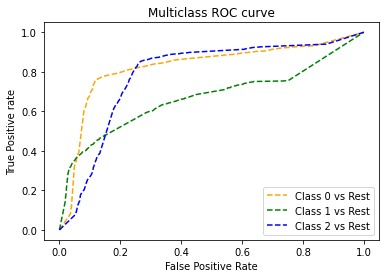

In [36]:
fig, ax = plt.subplots()

auc_list = [dt_test, rf_auc, knn_auc, log_model_auc, dummy_auc]

n_class = 3

fpr = {}
tpr = {}
thresh ={}

for i in range(n_class):    
    fpr[i], tpr[i], thresh[i] = roc_curve(y_test, dt_model_pred_proba[:,i], pos_label=i)
    
# plotting    
plt.plot(fpr[0], tpr[0], linestyle='--',color='orange', label='Class 0 vs Rest')
plt.plot(fpr[1], tpr[1], linestyle='--',color='green', label='Class 1 vs Rest')
plt.plot(fpr[2], tpr[2], linestyle='--',color='blue', label='Class 2 vs Rest')
plt.title('Multiclass ROC curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive rate')
plt.legend(loc='best')
plt.savefig('Multiclass ROC',dpi=300); 

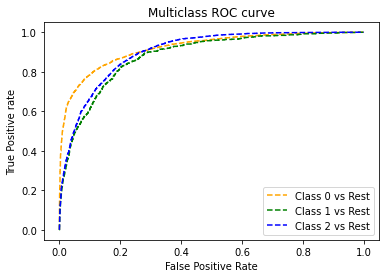

In [37]:
for i in range(n_class):    
    fpr[i], tpr[i], thresh[i] = roc_curve(y_test, rf_model_pred_proba[:,i], pos_label=i)
    
# plotting    
plt.plot(fpr[0], tpr[0], linestyle='--',color='orange', label='Class 0 vs Rest')
plt.plot(fpr[1], tpr[1], linestyle='--',color='green', label='Class 1 vs Rest')
plt.plot(fpr[2], tpr[2], linestyle='--',color='blue', label='Class 2 vs Rest')
plt.title('Multiclass ROC curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive rate')
plt.legend(loc='best')
plt.savefig('Multiclass ROC',dpi=300); 

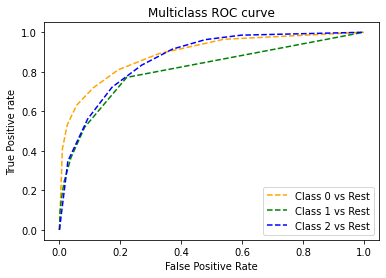

In [38]:
for i in range(n_class):    
    fpr[i], tpr[i], thresh[i] = roc_curve(y_test, knn_model_pred_proba[:,i], pos_label=i)
    
# plotting    
plt.plot(fpr[0], tpr[0], linestyle='--',color='orange', label='Class 0 vs Rest')
plt.plot(fpr[1], tpr[1], linestyle='--',color='green', label='Class 1 vs Rest')
plt.plot(fpr[2], tpr[2], linestyle='--',color='blue', label='Class 2 vs Rest')
plt.title('Multiclass ROC curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive rate')
plt.legend(loc='best')
plt.savefig('Multiclass ROC',dpi=300); 

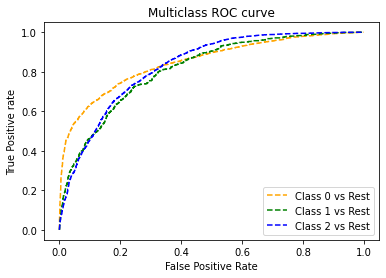

In [39]:
for i in range(n_class):    
    fpr[i], tpr[i], thresh[i] = roc_curve(y_test, log_model_pred_proba[:,i], pos_label=i)
    
# plotting    
plt.plot(fpr[0], tpr[0], linestyle='--',color='orange', label='Class 0 vs Rest')
plt.plot(fpr[1], tpr[1], linestyle='--',color='green', label='Class 1 vs Rest')
plt.plot(fpr[2], tpr[2], linestyle='--',color='blue', label='Class 2 vs Rest')
plt.title('Multiclass ROC curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive rate')
plt.legend(loc='best')
plt.savefig('Multiclass ROC',dpi=300); 

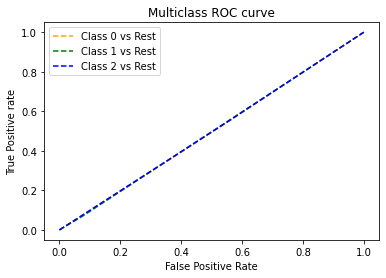

In [40]:
for i in range(n_class):    
    fpr[i], tpr[i], thresh[i] = roc_curve(y_test, dummy_model_pred_proba[:,i], pos_label=i)
    
# plotting    
plt.plot(fpr[0], tpr[0], linestyle='--',color='orange', label='Class 0 vs Rest')
plt.plot(fpr[1], tpr[1], linestyle='--',color='green', label='Class 1 vs Rest')
plt.plot(fpr[2], tpr[2], linestyle='--',color='blue', label='Class 2 vs Rest')
plt.title('Multiclass ROC curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive rate')
plt.legend(loc='best')
plt.savefig('Multiclass ROC',dpi=300); 

In [41]:
rf_model_pred_test = rf_model.predict(X_test_clean)

y_test_df = pd.DataFrame(y_test)
rf_model_pred_test_df = pd.DataFrame(rf_model_pred_test)
well_df = y_test_df.merge(X_test, on="id", how="outer")

well_df = well_df[['region', 'status']]


In [42]:
well_df = well_df.reset_index()

In [43]:
well_df

,id,region,status
0,39883,Kagera,2
1,59889,Morogoro,2
2,12400,Mwanza,2
3,65058,Iringa,2
4,1395,Tanga,2
...,...,...,...
11264,6442,Arusha,2
11265,58263,Tanga,0
11266,13734,Morogoro,2
11267,60158,Tanga,2


In [44]:
status_pred = rf_model_pred_test_df.copy()

In [45]:
status_pred

,0
0,2
1,2
2,2
3,0
4,2
...,...
11264,2
11265,0
11266,2
11267,2


In [46]:
combined = pd.concat([well_df, status_pred], axis=1)

In [47]:
combined = combined.rename(columns={0:"status_pred"})

In [48]:
combined

,id,region,status,status_pred
0,39883,Kagera,2,2
1,59889,Morogoro,2,2
2,12400,Mwanza,2,2
3,65058,Iringa,2,0
4,1395,Tanga,2,2
...,...,...,...,...
11264,6442,Arusha,2,2
11265,58263,Tanga,0,0
11266,13734,Morogoro,2,2
11267,60158,Tanga,2,2


In [49]:
actual_well = combined.groupby('region').agg({'status' : 'mean'})
pred_well = combined.groupby('region').agg({'status_pred' : 'mean'})

In [50]:
pred_well

,status_pred
region,
Arusha,1.694974
Dar es Salaam,1.150000
Dodoma,1.128146
Iringa,1.693452
Kagera,1.300926
Kigoma,1.361062
Kilimanjaro,1.342290
Lindi,0.671533
Manyara,1.350932


In [51]:
geoJSON_df = gpd.read_file('data/gadm36_TZA_1.geojson')
geoJSON_df = geoJSON_df.rename(columns = {"NAME_1":"region"})

In [52]:
final_df = geoJSON_df.merge(actual_well, on = "region", how="outer")

m = folium.Map(location=[-6.5, 36], zoom_start=6.4)

folium.Choropleth(
geo_data=final_df,
data=final_df,
columns=['region',"status"],
key_on="feature.properties.region",
fill_color='OrRd_r',
fill_opacity=1,
line_opacity=0.7,
legend_name="Nonfunctioning------------------------------------------------------Functioning",
smooth_factor=0,
Highlight= True,
line_color = "black",
name = "Wells",
show=False,
overlay=True,
nan_fill_color = "White"
).add_to(m)

m

In [53]:
final_df_pred = geoJSON_df.merge(pred_well, on = "region", how="outer")


m1 = folium.Map(location=[-6.5, 36], zoom_start=6.4)

folium.Choropleth(
geo_data=final_df_pred,
data=final_df_pred,
columns=['region',"status_pred"],
key_on="feature.properties.region",
fill_color='OrRd_r',
fill_opacity=1,
line_opacity=0.7,
legend_name="Nonfunctioning------------------------------------------------------Functioning",
smooth_factor=0,
Highlight= True,
line_color = "black",
name = "Wells",
show=False,
overlay=True,
nan_fill_color = "White"
).add_to(m1)

m1

In [54]:
X_submit = X_submit.drop(['scheme_name', 
                         'num_private', 
                         'lga', 
                         'ward', 
                         'recorded_by', 
                         'extraction_type',
                         'extraction_type_class',
                         'management_group',
                         'payment',
                         'water_quality',
                         'quantity',
                         'source',
                         'source_class',
                         'waterpoint_type',
                         'date_recorded',
                         'public_meeting',
                         'scheme_management', 
                         'funder',
                         'installer',
                         'wpt_name',
                         'subvillage'], axis=1)

In [55]:
X_submit = X_submit.dropna()
X_submit['permit'] = X_submit['permit'].astype(int)
X_submit = X_submit.set_index('id')

X_submit.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 14113 entries, 50785 to 68707
Data columns (total 18 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   amount_tsh             14113 non-null  float64
 1   gps_height             14113 non-null  int64  
 2   longitude              14113 non-null  float64
 3   latitude               14113 non-null  float64
 4   basin                  14113 non-null  object 
 5   region                 14113 non-null  object 
 6   region_code            14113 non-null  int64  
 7   district_code          14113 non-null  int64  
 8   population             14113 non-null  int64  
 9   permit                 14113 non-null  int64  
 10  construction_year      14113 non-null  int64  
 11  extraction_type_group  14113 non-null  object 
 12  management             14113 non-null  object 
 13  payment_type           14113 non-null  object 
 14  quality_group          14113 non-null  object 
 15

In [56]:
xx = X_submit.copy()

xx_ohe = xx.select_dtypes('object')
xx_ohe = pd.concat([xx_ohe, xx[['region_code', 'district_code']]], axis=1)


xx_ohe_trans = ohe.transform(xx_ohe)

xx_df = pd.DataFrame(xx_ohe_trans, columns=ohe.get_feature_names(), index=xx.index)



xx_ss = xx.select_dtypes(exclude='object').drop(['permit','region_code','district_code'], axis=1)

xx_scaled = ss.transform(xx_ss)


xx_df1 = pd.DataFrame(xx_scaled, index=xx.index, columns=xx_ss.columns)



xx_df2 = xx[['permit']]


submission_cleaned = pd.concat([xx_df1, xx_df2, xx_df], axis=1)
submission_cleaned

,amount_tsh,gps_height,longitude,latitude,population,construction_year,permit,x0_Lake Nyasa,x0_Lake Rukwa,x0_Lake Tanganyika,...,x10_23,x10_30,x10_33,x10_43,x10_53,x10_60,x10_62,x10_63,x10_67,x10_80
id,,,,,,,,,,,,,,,,,,,,,
50785,-0.116706,1.939231,0.185133,0.556258,0.307188,0.747523,1,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
51630,-0.116706,1.321103,0.388060,0.810021,0.261808,0.734914,1,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
45559,-0.116706,-0.563681,0.596250,-1.255789,0.153762,0.721254,1,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
49871,0.061036,0.873792,0.142840,-1.773721,-0.256815,0.734914,1,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
52449,-0.116706,1.489025,0.392305,0.812319,0.045715,0.724406,1,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
68174,-0.116706,-0.950192,0.007758,0.887631,-0.386471,-1.366640,0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
39307,-0.116706,-0.900974,0.714304,-0.296900,-0.343252,0.722305,1,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
18990,0.238777,-0.950192,0.506159,0.119819,6.009884,0.728609,0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [57]:
rf_model_submission_predict = rf_model.predict(submission_cleaned)
rf_sub = pd.DataFrame(rf_model_submission_predict)
final_submit = xx[['region']]
final_submit = final_submit.reset_index()
finalll = pd.concat([final_submit, rf_sub], axis=1)

In [58]:
finalll = finalll.rename(columns={0:"status_sub"})
finalll = finalll.groupby('region').agg({'status_sub':'mean'})
finalll

,status_sub
region,
Arusha,1.692190
Dar es Salaam,1.330049
Dodoma,1.112457
Iringa,1.660536
Kagera,1.256410
Kigoma,1.337517
Kilimanjaro,1.393352
Lindi,0.711230
Manyara,1.460154


In [59]:
final_sub_df = geoJSON_df.merge(finalll, on = "region", how="outer")

m = folium.Map(location=[-6.5, 36], zoom_start=6.4)

folium.Choropleth(
geo_data=final_sub_df,
data=final_sub_df,
columns=['region',"status_sub"],
key_on="feature.properties.region",
fill_color='OrRd_r',
fill_opacity=1,
line_opacity=0.7,
legend_name="Nonfunctioning------------------------------------------------------Functioning",
smooth_factor=0,
Highlight= True,
line_color = "black",
name = "Wells",
show=False,
overlay=True,
nan_fill_color = "White"
).add_to(m)

m